In [ ]:
#Importing Required Libraries
#1. Numpy : For calculations and numerical process
#2. Pandas : Data Analysis and Manipulation
#3. Matplotlib : Data Visualisation 
#4. Seaborn : Data Visualisation

In [2]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
!pip install sklearn

In [ ]:
#Importing Dataset 

In [3]:
df=pd.read_csv('city_day.csv',parse_dates = ["Date"])
df

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory


#Training Data Preprocessing

In [4]:
#Number of rows and columns in Dataset
df.shape

(29531, 16)

In [5]:
#Information of Data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   City        29531 non-null  object        
 1   Date        29531 non-null  datetime64[ns]
 2   PM2.5       24933 non-null  float64       
 3   PM10        18391 non-null  float64       
 4   NO          25949 non-null  float64       
 5   NO2         25946 non-null  float64       
 6   NOx         25346 non-null  float64       
 7   NH3         19203 non-null  float64       
 8   CO          27472 non-null  float64       
 9   SO2         25677 non-null  float64       
 10  O3          25509 non-null  float64       
 11  Benzene     23908 non-null  float64       
 12  Toluene     21490 non-null  float64       
 13  Xylene      11422 non-null  float64       
 14  AQI         24850 non-null  float64       
 15  AQI_Bucket  24850 non-null  object        
dtypes: datetime64[ns](1), 

In [6]:
#Checking For missing values
df.isnull().sum()

City              0
Date              0
PM2.5          4598
PM10          11140
NO             3582
NO2            3585
NOx            4185
NH3           10328
CO             2059
SO2            3854
O3             4022
Benzene        5623
Toluene        8041
Xylene        18109
AQI            4681
AQI_Bucket     4681
dtype: int64

<AxesSubplot:>

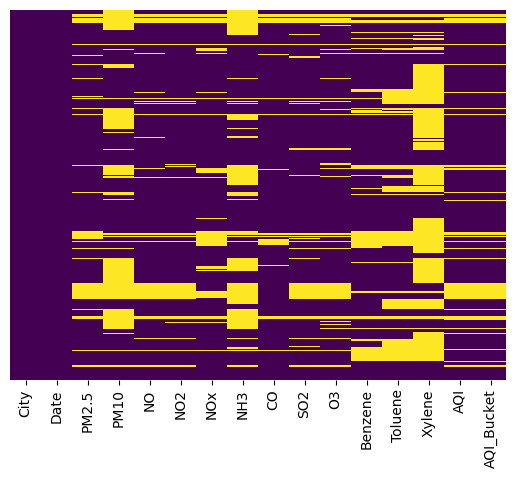

In [7]:
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

As shown in the graph,there are multiple missing values


Here We can observe what percent of the given Data is missing.

In [9]:
(df.isnull().sum()/df.shape[0]*100).sort_values(ascending=False)

Xylene        61.322001
PM10          37.723071
NH3           34.973418
Toluene       27.229014
Benzene       19.041008
AQI           15.851139
AQI_Bucket    15.851139
PM2.5         15.570079
NOx           14.171549
O3            13.619586
SO2           13.050692
NO2           12.139785
NO            12.129626
CO             6.972334
City           0.000000
Date           0.000000
dtype: float64

In [10]:
#Statistical Analysis 
df.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000
mean,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581
std,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585
min,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000
25%,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000
50%,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000
75%,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000
max,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000


In [11]:
#converting dtype of date column to datetime
df['Date']=df['Date'].apply(pd.to_datetime)
#setting date column as index
df.set_index('Date',inplace=True)

In [12]:
df


,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
2015-01-02,Ahmedabad,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2015-01-03,Ahmedabad,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
2015-01-04,Ahmedabad,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
2015-01-05,Ahmedabad,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
2020-06-28,Visakhapatnam,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
2020-06-29,Visakhapatnam,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory


In [ ]:
#Filling the Nan values present in the pollutants with mean values of data(city Wise)

In [13]:
df.iloc[:, 1:13] = df.groupby("City").transform(lambda x: x.fillna(x.mean()))
df

C:\Users\admin\AppData\Local\Temp\ipykernel_4736\1750266359.py:1: FutureWarning: Dropping invalid columns in DataFrameGroupBy.transform is deprecated. In a future version, a TypeError will be raised. Before calling .transform, select only columns which should be valid for the function.
  df.iloc[:, 1:13] = df.groupby("City").transform(lambda x: x.fillna(x.mean()))


,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.000000,0.020000,0.000000,NaN,NaN
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.680000,5.500000,3.770000,NaN,NaN
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.800000,16.400000,2.250000,NaN,NaN
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.430000,10.140000,1.000000,NaN,NaN
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.010000,18.890000,2.780000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.240000,12.070000,0.730000,41.0,Good
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.740000,2.210000,0.380000,70.0,Satisfactory
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.010000,0.010000,0.000000,68.0,Satisfactory


In [14]:
df.isnull().sum()

City              0
PM2.5             0
PM10           2009
NO                0
NO2               0
NOx            1169
NH3            2009
CO                0
SO2               0
O3              162
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [15]:
df.head(30)

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.920000,18.22,17.15,NaN,0.920000,27.64,133.36,0.00,0.02,0.00,NaN,NaN
2015-01-02,Ahmedabad,67.854497,114.584029,0.970000,15.69,16.46,NaN,0.970000,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2015-01-03,Ahmedabad,67.854497,114.584029,17.400000,19.30,29.70,NaN,17.400000,29.07,30.70,6.80,16.40,2.25,NaN,NaN
2015-01-04,Ahmedabad,67.854497,114.584029,1.700000,18.48,17.97,NaN,1.700000,18.59,36.08,4.43,10.14,1.00,NaN,NaN
2015-01-05,Ahmedabad,67.854497,114.584029,22.100000,21.42,37.76,NaN,22.100000,39.33,39.31,7.01,18.89,2.78,NaN,NaN
2015-01-06,Ahmedabad,67.854497,114.584029,45.410000,38.48,81.50,NaN,45.410000,45.76,46.51,5.42,10.83,1.93,NaN,NaN
2015-01-07,Ahmedabad,67.854497,114.584029,112.160000,40.62,130.77,NaN,112.160000,32.28,33.47,0.00,0.00,0.00,NaN,NaN
2015-01-08,Ahmedabad,67.854497,114.584029,80.870000,36.74,96.75,NaN,80.870000,38.54,31.89,0.00,0.00,0.00,NaN,NaN
2015-01-09,Ahmedabad,67.854497,114.584029,29.160000,31.00,48.00,NaN,29.160000,58.68,25.75,0.00,0.00,0.00,NaN,NaN


<AxesSubplot:ylabel='Date'>

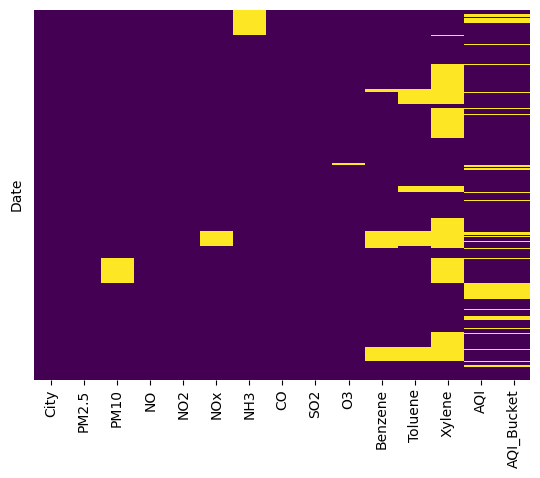

In [16]:
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

In [17]:
df.isnull().sum()

City              0
PM2.5             0
PM10           2009
NO                0
NO2               0
NOx            1169
NH3            2009
CO                0
SO2               0
O3              162
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [18]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.000000,0.020000,0.000000,NaN,NaN
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.680000,5.500000,3.770000,NaN,NaN
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.800000,16.400000,2.250000,NaN,NaN
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.430000,10.140000,1.000000,NaN,NaN
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.010000,18.890000,2.780000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.240000,12.070000,0.730000,41.0,Good
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.740000,2.210000,0.380000,70.0,Satisfactory
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.010000,0.010000,0.000000,68.0,Satisfactory


In [19]:
df.head(20)

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.920000,18.22,17.15,NaN,0.920000,27.64,133.36,0.00,0.02,0.00,NaN,NaN
2015-01-02,Ahmedabad,67.854497,114.584029,0.970000,15.69,16.46,NaN,0.970000,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2015-01-03,Ahmedabad,67.854497,114.584029,17.400000,19.30,29.70,NaN,17.400000,29.07,30.70,6.80,16.40,2.25,NaN,NaN
2015-01-04,Ahmedabad,67.854497,114.584029,1.700000,18.48,17.97,NaN,1.700000,18.59,36.08,4.43,10.14,1.00,NaN,NaN
2015-01-05,Ahmedabad,67.854497,114.584029,22.100000,21.42,37.76,NaN,22.100000,39.33,39.31,7.01,18.89,2.78,NaN,NaN
2015-01-06,Ahmedabad,67.854497,114.584029,45.410000,38.48,81.50,NaN,45.410000,45.76,46.51,5.42,10.83,1.93,NaN,NaN
2015-01-07,Ahmedabad,67.854497,114.584029,112.160000,40.62,130.77,NaN,112.160000,32.28,33.47,0.00,0.00,0.00,NaN,NaN
2015-01-08,Ahmedabad,67.854497,114.584029,80.870000,36.74,96.75,NaN,80.870000,38.54,31.89,0.00,0.00,0.00,NaN,NaN
2015-01-09,Ahmedabad,67.854497,114.584029,29.160000,31.00,48.00,NaN,29.160000,58.68,25.75,0.00,0.00,0.00,NaN,NaN


Filling remaining values with mean

In [20]:
#filling the null values
df["PM10"].mean()
P =df["PM10"].mean()

In [21]:
df["PM10"].fillna(value=P,inplace=True)

In [22]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx            1169
NH3            2009
CO                0
SO2               0
O3              162
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 29531 entries, 2015-01-01 to 2020-07-01
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   PM2.5       29531 non-null  float64
 2   PM10        29531 non-null  float64
 3   NO          29531 non-null  float64
 4   NO2         29531 non-null  float64
 5   NOx         28362 non-null  float64
 6   NH3         27522 non-null  float64
 7   CO          29531 non-null  float64
 8   SO2         29531 non-null  float64
 9   O3          29369 non-null  float64
 10  Benzene     26799 non-null  float64
 11  Toluene     25521 non-null  float64
 12  Xylene      16484 non-null  float64
 13  AQI         24850 non-null  float64
 14  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(2)
memory usage: 3.6+ MB


In [24]:
df["NOx"].mean()
n=df["NOx"].mean()

In [25]:
df["NOx"].fillna(value=n,inplace = True)

In [26]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3            2009
CO                0
SO2               0
O3              162
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 29531 entries, 2015-01-01 to 2020-07-01
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   PM2.5       29531 non-null  float64
 2   PM10        29531 non-null  float64
 3   NO          29531 non-null  float64
 4   NO2         29531 non-null  float64
 5   NOx         29531 non-null  float64
 6   NH3         27522 non-null  float64
 7   CO          29531 non-null  float64
 8   SO2         29531 non-null  float64
 9   O3          29369 non-null  float64
 10  Benzene     26799 non-null  float64
 11  Toluene     25521 non-null  float64
 12  Xylene      16484 non-null  float64
 13  AQI         24850 non-null  float64
 14  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(2)
memory usage: 3.6+ MB


In [28]:
df["NH3"].mean()
NH = df["NH3"].mean()

In [29]:
df["NH3"].fillna(value=NH,inplace = True)

In [30]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3               0
CO                0
SO2               0
O3              162
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [31]:
df["O3"].mean()
O= df["O3"].mean()

In [32]:
df["O3"].fillna(value=O,inplace = True)

In [33]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3               0
CO                0
SO2               0
O3                0
Benzene        2732
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [34]:
df["Benzene"].mean()
B = df["Benzene"].mean()

In [35]:
df["Benzene"].fillna(value = B,inplace = True)

In [36]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3               0
CO                0
SO2               0
O3                0
Benzene           0
Toluene        4010
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [37]:
df["Toluene"].mean()
T = df["Toluene"].mean()

In [38]:
df["Toluene"].fillna (value= T,inplace = True)

In [39]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3               0
CO                0
SO2               0
O3                0
Benzene           0
Toluene           0
Xylene        13047
AQI            4681
AQI_Bucket     4681
dtype: int64

In [40]:
df["Xylene"].mean()
X = df["Xylene"].mean()

In [41]:
df["Xylene"].fillna(value=X,inplace=True)

In [42]:
df.isnull().sum()

City             0
PM2.5            0
PM10             0
NO               0
NO2              0
NOx              0
NH3              0
CO               0
SO2              0
O3               0
Benzene          0
Toluene          0
Xylene           0
AQI           4681
AQI_Bucket    4681
dtype: int64

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 29531 entries, 2015-01-01 to 2020-07-01
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   PM2.5       29531 non-null  float64
 2   PM10        29531 non-null  float64
 3   NO          29531 non-null  float64
 4   NO2         29531 non-null  float64
 5   NOx         29531 non-null  float64
 6   NH3         29531 non-null  float64
 7   CO          29531 non-null  float64
 8   SO2         29531 non-null  float64
 9   O3          29531 non-null  float64
 10  Benzene     29531 non-null  float64
 11  Toluene     29531 non-null  float64
 12  Xylene      29531 non-null  float64
 13  AQI         24850 non-null  float64
 14  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(2)
memory usage: 3.6+ MB


In [44]:
df.head()

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [45]:
#Creating and Calculating Sub-Index for better results

In [46]:
# PM10 Sub-Index calculation
def get_PM10_subindex(x):
    if x <= 50:
        return x
    elif x > 50 and x <= 100:
        return x
    elif x > 100 and x <= 250:
        return 100 + (x - 100) * 100 / 150
    elif x > 250 and x <= 350:
        return 200 + (x - 250)
    elif x > 350 and x <= 430:
        return 300 + (x - 350) * 100 / 80
    elif x > 430:
        return 400 + (x - 430) * 100 / 80
    else:
        return 0
df["PM10_SubIndex"]=df["PM10"].astype(float).apply(lambda x:get_PM10_subindex(x))

In [47]:
# PM2.5 Sub-Index calculation
def get_PM25_subindex(x):
    if x <= 30:
        return x * 50 / 30
    elif x > 30 and x <= 60:
        return 50 + (x - 30) * 50 / 30
    elif x > 60 and x <= 90:
        return 100 + (x - 60) * 100 / 30
    elif x > 90 and x <= 120:
        return 200 + (x - 90) * 100 / 30
    elif x > 120 and x <= 250:
        return 300 + (x - 120) * 100 / 130
    elif x > 250:
        return 400 + (x - 250) * 100 / 130
    else:
        return 0

df["PM2.5_SubIndex"] = df["PM2.5"].astype(int).apply(lambda x: get_PM25_subindex(x))


In [48]:
# SO2 Sub-Index calculation
def get_SO2_subindex(x):
    if x <= 40:
        return x * 50 / 40
    elif x > 40 and x <= 80:
        return 50 + (x - 40) * 50 / 40
    elif x > 80 and x <= 380:
        return 100 + (x - 80) * 100 / 300
    elif x > 380 and x <= 800:
        return 200 + (x - 380) * 100 / 420
    elif x > 800 and x <= 1600:
        return 300 + (x - 800) * 100 / 800
    elif x > 1600:
        return 400 + (x - 1600) * 100 / 800
    else:
        return 0

df["SO2_SubIndex"] = df["SO2"].astype(int).apply(lambda x: get_SO2_subindex(x))


In [49]:
# NOx Sub-Index calculation
def get_NOx_subindex(x):
    if x <= 40:
        return x * 50 / 40
    elif x > 40 and x <= 80:
        return 50 + (x - 40) * 50 / 40
    elif x > 80 and x <= 180:
        return 100 + (x - 80) * 100 / 100
    elif x > 180 and x <= 280:
        return 200 + (x - 180) * 100 / 100
    elif x > 280 and x <= 400:
        return 300 + (x - 280) * 100 / 120
    elif x > 400:
        return 400 + (x - 400) * 100 / 120
    else:
        return 0

df["NOx_SubIndex"] = df["NOx"].astype(int).apply(lambda x: get_NOx_subindex(x))


In [50]:
# NH3 Sub-Index calculation
def get_NH3_subindex(x):
    if x <= 200:
        return x * 50 / 200
    elif x > 200 and x <= 400:
        return 50 + (x - 200) * 50 / 200
    elif x > 400 and x <= 800:
        return 100 + (x - 400) * 100 / 400
    elif x > 800 and x <= 1200:
        return 200 + (x - 800) * 100 / 400
    elif x > 1200 and x <= 1800:
        return 300 + (x - 1200) * 100 / 600
    elif x > 1800:
        return 400 + (x - 1800) * 100 / 600
    else:
        return 0

df["NH3_SubIndex"] = df["NH3"].astype(int).apply(lambda x: get_NH3_subindex(x))


In [51]:
# CO Sub-Index calculation
def get_CO_subindex(x):
    if x <= 1:
        return x * 50 / 1
    elif x > 1 and x <= 2:
        return 50 + (x - 1) * 50 / 1
    elif x > 2 and x <= 10:
        return 100 + (x - 2) * 100 / 8
    elif x > 10 and x <= 17:
        return 200 + (x - 10) * 100 / 7
    elif x > 17 and x <= 34:
        return 300 + (x - 17) * 100 / 17
    elif x > 34:
        return 400 + (x - 34) * 100 / 17
    else:
        return 0

df["CO_SubIndex"] = df["CO"].astype(int).apply(lambda x: get_CO_subindex(x))

In [52]:
# O3 Sub-Index calculation
def get_O3_subindex(x):
    if x <= 50:
        return x * 50 / 50
    elif x > 50 and x <= 100:
        return 50 + (x - 50) * 50 / 50
    elif x > 100 and x <= 168:
        return 100 + (x - 100) * 100 / 68
    elif x > 168 and x <= 208:
        return 200 + (x - 168) * 100 / 40
    elif x > 208 and x <= 748:
        return 300 + (x - 208) * 100 / 539
    elif x > 748:
        return 400 + (x - 400) * 100 / 539
    else:
        return 0

df["O3_SubIndex"] = df["O3"].astype(int).apply(lambda x: get_O3_subindex(x))

In [53]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,...,0.000000,NaN,NaN,109.722686,123.333333,33.75,21.25,5.75,0.000000,148.529412
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,...,3.770000,NaN,NaN,109.722686,123.333333,30.00,20.00,5.75,0.000000,34.000000
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,...,2.250000,NaN,NaN,109.722686,123.333333,36.25,36.25,5.75,300.000000,30.000000
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,...,1.000000,NaN,NaN,109.722686,123.333333,22.50,21.25,5.75,50.000000,36.000000
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,...,2.780000,NaN,NaN,109.722686,123.333333,48.75,46.25,5.75,329.411765,39.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.470000,0.47,8.55,23.30,...,0.730000,41.0,Good,50.940000,25.000000,10.00,23.75,3.00,0.000000,23.000000
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.990000,0.52,12.72,30.14,...,0.380000,70.0,Satisfactory,74.090000,40.000000,15.00,20.00,2.75,0.000000,30.000000
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.710000,0.48,8.42,30.96,...,0.000000,68.0,Satisfactory,65.730000,36.666667,10.00,22.50,2.50,0.000000,30.000000


<AxesSubplot:ylabel='Date'>

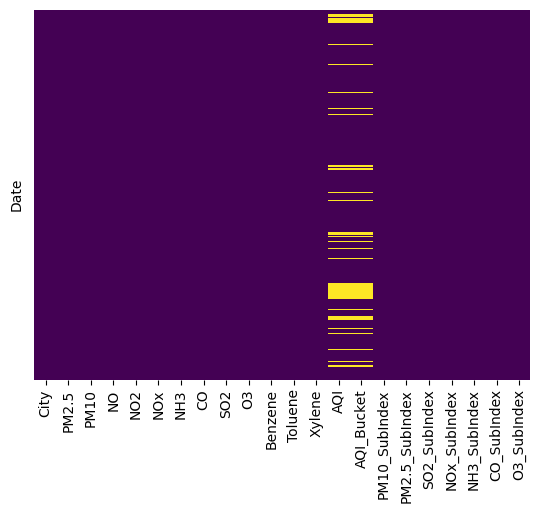

In [54]:
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap="viridis")

In [55]:
df.isnull().sum()

City                 0
PM2.5                0
PM10                 0
NO                   0
NO2                  0
NOx                  0
NH3                  0
CO                   0
SO2                  0
O3                   0
Benzene              0
Toluene              0
Xylene               0
AQI               4681
AQI_Bucket        4681
PM10_SubIndex        0
PM2.5_SubIndex       0
SO2_SubIndex         0
NOx_SubIndex         0
NH3_SubIndex         0
CO_SubIndex          0
O3_SubIndex          0
dtype: int64

In [56]:
#Removing the nan values from AQI

In [57]:
df["AQI"].mean()
a =df["AQI"].mean()
df["AQI"].fillna(value = a , inplace = True)

In [58]:
df.isnull().sum()

City                 0
PM2.5                0
PM10                 0
NO                   0
NO2                  0
NOx                  0
NH3                  0
CO                   0
SO2                  0
O3                   0
Benzene              0
Toluene              0
Xylene               0
AQI                  0
AQI_Bucket        4681
PM10_SubIndex        0
PM2.5_SubIndex       0
SO2_SubIndex         0
NOx_SubIndex         0
NH3_SubIndex         0
CO_SubIndex          0
O3_SubIndex          0
dtype: int64

In [59]:
df["AQI_Bucket"].mode()


0    Moderate
Name: AQI_Bucket, dtype: object

In [60]:
s = df["AQI_Bucket"].mode()

In [61]:
df["AQI_Bucket"].fillna(value = 2,inplace = True)

In [62]:
df.isnull().sum()

City              0
PM2.5             0
PM10              0
NO                0
NO2               0
NOx               0
NH3               0
CO                0
SO2               0
O3                0
Benzene           0
Toluene           0
Xylene            0
AQI               0
AQI_Bucket        0
PM10_SubIndex     0
PM2.5_SubIndex    0
SO2_SubIndex      0
NOx_SubIndex      0
NH3_SubIndex      0
CO_SubIndex       0
O3_SubIndex       0
dtype: int64

In [63]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,...,0.000000,166.463581,2,109.722686,123.333333,33.75,21.25,5.75,0.000000,148.529412
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,...,3.770000,166.463581,2,109.722686,123.333333,30.00,20.00,5.75,0.000000,34.000000
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,...,2.250000,166.463581,2,109.722686,123.333333,36.25,36.25,5.75,300.000000,30.000000
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,...,1.000000,166.463581,2,109.722686,123.333333,22.50,21.25,5.75,50.000000,36.000000
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,...,2.780000,166.463581,2,109.722686,123.333333,48.75,46.25,5.75,329.411765,39.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.470000,0.47,8.55,23.30,...,0.730000,41.000000,Good,50.940000,25.000000,10.00,23.75,3.00,0.000000,23.000000
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.990000,0.52,12.72,30.14,...,0.380000,70.000000,Satisfactory,74.090000,40.000000,15.00,20.00,2.75,0.000000,30.000000
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.710000,0.48,8.42,30.96,...,0.000000,68.000000,Satisfactory,65.730000,36.666667,10.00,22.50,2.50,0.000000,30.000000


In [64]:
a = {"Good":0,"Satisfactory":1,"Moderate":2,"Poor":3,"Very Poor":4,"Severe":5,2:2}

In [65]:
df["AQI_Bucket"]=df["AQI_Bucket"].map(a)

In [66]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,...,0.000000,166.463581,2,109.722686,123.333333,33.75,21.25,5.75,0.000000,148.529412
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,...,3.770000,166.463581,2,109.722686,123.333333,30.00,20.00,5.75,0.000000,34.000000
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,...,2.250000,166.463581,2,109.722686,123.333333,36.25,36.25,5.75,300.000000,30.000000
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,...,1.000000,166.463581,2,109.722686,123.333333,22.50,21.25,5.75,50.000000,36.000000
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,...,2.780000,166.463581,2,109.722686,123.333333,48.75,46.25,5.75,329.411765,39.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.470000,0.47,8.55,23.30,...,0.730000,41.000000,0,50.940000,25.000000,10.00,23.75,3.00,0.000000,23.000000
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.990000,0.52,12.72,30.14,...,0.380000,70.000000,1,74.090000,40.000000,15.00,20.00,2.75,0.000000,30.000000
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.710000,0.48,8.42,30.96,...,0.000000,68.000000,1,65.730000,36.666667,10.00,22.50,2.50,0.000000,30.000000


In [67]:
df.sample(10)

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2020-05-28,Guwahati,15.12,28.910000,0.94,6.03,3.640000,0.860000,0.37,15.07,44.220000,...,3.114350,53.0,1,28.910000,25.000000,18.75,3.75,0.00,0.0,44.0
2020-04-30,Jorapokhar,40.24,113.360000,25.97,10.16,32.855058,9.030000,0.96,35.18,29.000000,...,3.114350,104.0,2,108.906667,66.666667,43.75,40.00,2.25,0.0,29.0
2019-12-28,Coimbatore,29.87,37.200000,0.68,16.25,15.800000,7.940000,0.05,2.57,44.050000,...,3.114350,74.0,1,37.200000,48.333333,2.50,18.75,1.75,0.0,44.0
2019-05-29,Chennai,54.73,62.834404,7.94,13.96,20.240000,23.030000,1.31,7.30,38.780000,...,3.114350,137.0,2,62.834404,90.000000,8.75,25.00,5.75,50.0,38.0
2019-11-24,Chandigarh,44.90,76.480000,2.60,18.03,20.070000,5.000000,0.45,10.79,8.990000,...,1.190000,107.0,2,76.480000,73.333333,12.50,25.00,1.25,0.0,8.0
2019-04-25,Gurugram,103.59,378.490000,15.75,17.83,29.340000,26.094454,0.84,4.65,53.230000,...,5.722437,313.0,4,335.612500,243.333333,5.00,36.25,6.50,0.0,53.0
2017-09-21,Jaipur,37.63,123.450000,12.00,42.54,39.637176,64.550000,0.70,7.96,46.715469,...,3.114350,125.0,2,115.633333,61.666667,8.75,48.75,16.00,0.0,46.0
2015-08-28,Bengaluru,18.96,83.243287,3.22,21.16,12.180000,26.370000,1.96,1.42,4.190000,...,3.114350,63.0,1,83.243287,30.000000,1.25,15.00,6.50,50.0,4.0
2020-01-24,Kolkata,84.27,164.390000,50.67,58.79,109.030000,21.230000,0.93,15.39,38.160000,...,3.420000,248.0,3,142.926667,180.000000,18.75,129.00,5.25,0.0,38.0


In [ ]:
#AQI Bucketing
def get_AQI_bucket(x):
    if x <= 50:
        return "Good"
    elif x > 50 and x <= 100:
        return "Satisfactory"
    elif x > 100 and x <= 200:
        return "Moderate"
    elif x > 200 and x <= 300:
        return "Poor"
    elif x > 300 and x <= 400:
        return "Very Poor"
    elif x > 400:
        return "Severe"
    else :
        return "0"
df[ "AQI_Bucket"] = df["AQI_Bucket"].apply(df["AQI"].apply( :get_AQI_bucket(x))

In [69]:
df_city_day = df.copy()
df_city_day.columns

Index(['City', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3',
       'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket', 'PM10_SubIndex',
       'PM2.5_SubIndex', 'SO2_SubIndex', 'NOx_SubIndex', 'NH3_SubIndex',
       'CO_SubIndex', 'O3_SubIndex'],
      dtype='object')

Graph showing correlation between features of the data

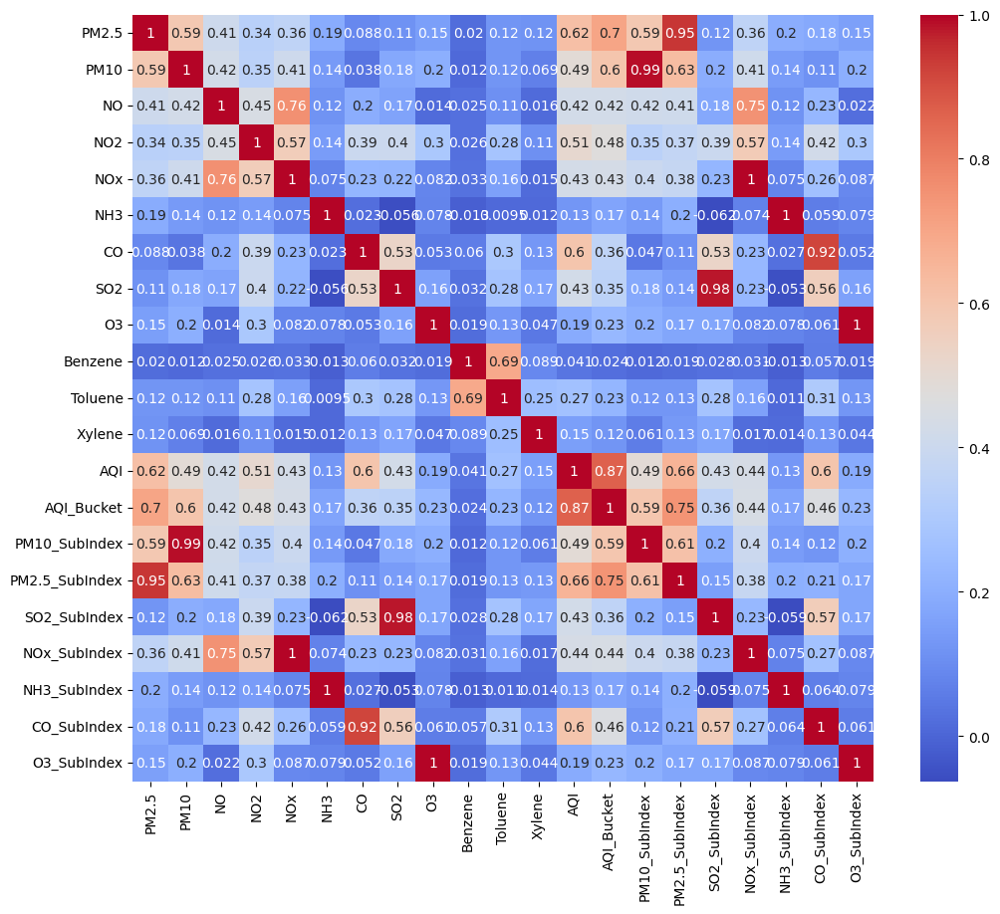

In [71]:
plt.figure(figsize=(12,10))
sns.heatmap(df.corr(),cmap='coolwarm',annot=True);

Distribution of different pollutants in last 5 years


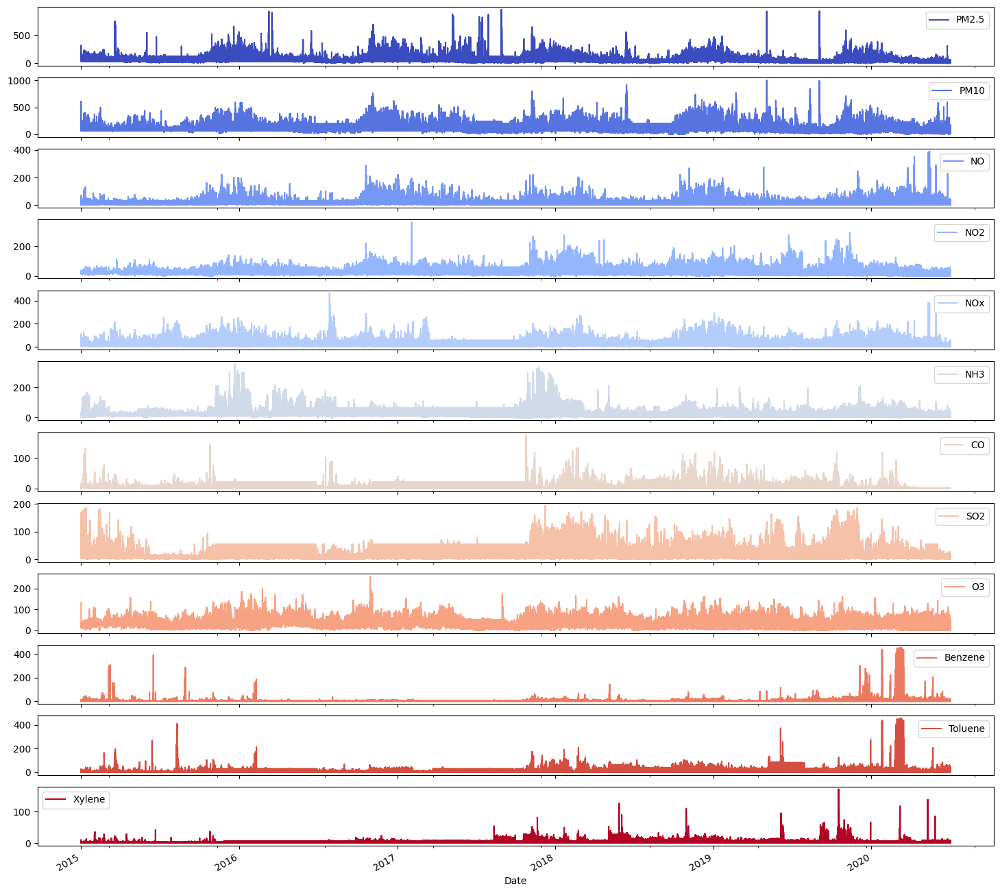

In [72]:
pollutants = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2','O3', 'Benzene', 'Toluene', 'Xylene']
df_city_day = df_city_day[pollutants]

print('Distribution of different pollutants in last 5 years')
df_city_day.plot(kind='line',figsize=(18,18),cmap='coolwarm',subplots=True,fontsize=10);

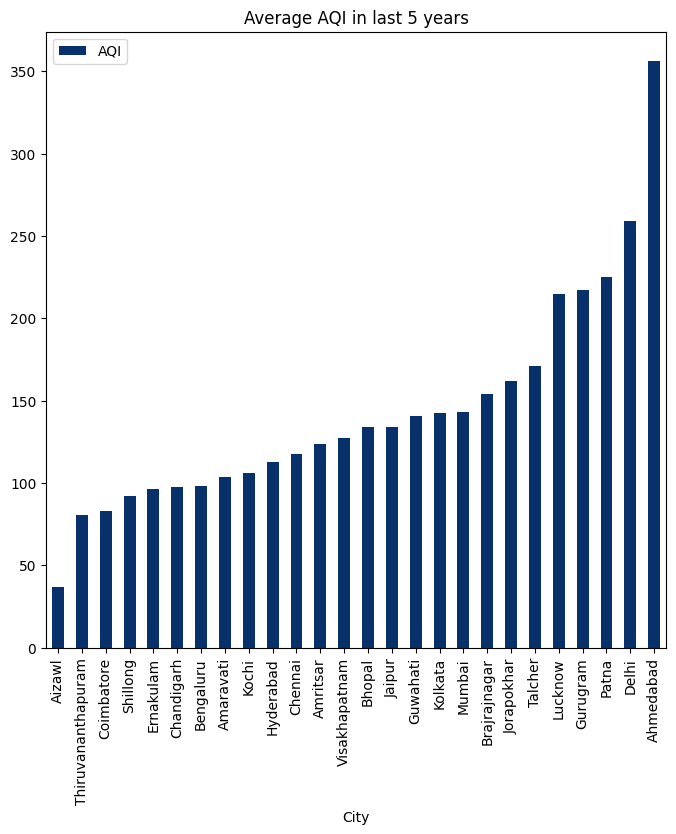

In [73]:
df[['City','AQI']].groupby('City').mean().sort_values('AQI').plot(kind='bar',cmap='Blues_r',figsize=(8,8))
plt.title('Average AQI in last 5 years');

In [ ]:
# By the above graph we can conclude that Ahemadabad is the highest polluted
# city followed by Delhi and Patna. 

In [ ]:
#Distribution of Values 

In [74]:
import plotly.express as px
fig = px.scatter(df,x ="PM2.5",y = "AQI")
fig.show()

In [75]:
import plotly.express as px
fig = px.scatter(df,x ="PM10",y = "AQI")
fig.show()

In [76]:
import plotly.express as px
fig = px.scatter(df,x ="NOx",y = "AQI")
fig.show()

In [77]:
import plotly.express as px
fig = px.scatter(df,x ="NO2",y = "AQI")
fig.show()

In [78]:
import plotly.express as px
fig = px.scatter(df,x ="NH3",y = "AQI")
fig.show()

In [79]:
import plotly.express as px
fig = px.scatter(df,x ="O3",y = "AQI")
fig.show()

In [80]:
import plotly.express as px
fig = px.scatter(df,x ="SO2",y = "AQI")
fig.show()

In [81]:
import plotly.express as px
fig = px.scatter(df,x ="CO",y = "AQI")
fig.show()

In [82]:
import plotly.express as px
fig = px.scatter(df,x ="Benzene",y = "AQI")
fig.show()

In [83]:
import plotly.express as px
fig = px.scatter(df,x ="Toluene",y = "AQI")
fig.show()

In [84]:
import plotly.express as px
fig = px.scatter(df,x ="Xylene",y = "AQI")
fig.show()

In [85]:
final_df = df[['AQI','AQI_Bucket']].copy()
final_df

,AQI,AQI_Bucket
Date,,
2015-01-01,166.463581,2
2015-01-02,166.463581,2
2015-01-03,166.463581,2
2015-01-04,166.463581,2
2015-01-05,166.463581,2
...,...,...
2020-06-27,41.000000,0
2020-06-28,70.000000,1
2020-06-29,68.000000,1


In [86]:
final_df ["AQI_Bucket"].unique()

array([2, 3, 4, 5, 1, 0], dtype=int64)

In [ ]:
#fitting model using different Models

In [87]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,...,0.000000,166.463581,2,109.722686,123.333333,33.75,21.25,5.75,0.000000,148.529412
2015-01-02,Ahmedabad,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,...,3.770000,166.463581,2,109.722686,123.333333,30.00,20.00,5.75,0.000000,34.000000
2015-01-03,Ahmedabad,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,...,2.250000,166.463581,2,109.722686,123.333333,36.25,36.25,5.75,300.000000,30.000000
2015-01-04,Ahmedabad,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,...,1.000000,166.463581,2,109.722686,123.333333,22.50,21.25,5.75,50.000000,36.000000
2015-01-05,Ahmedabad,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,...,2.780000,166.463581,2,109.722686,123.333333,48.75,46.25,5.75,329.411765,39.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,12.470000,0.47,8.55,23.30,...,0.730000,41.000000,0,50.940000,25.000000,10.00,23.75,3.00,0.000000,23.000000
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,11.990000,0.52,12.72,30.14,...,0.380000,70.000000,1,74.090000,40.000000,15.00,20.00,2.75,0.000000,30.000000
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,10.710000,0.48,8.42,30.96,...,0.000000,68.000000,1,65.730000,36.666667,10.00,22.50,2.50,0.000000,30.000000


In [88]:
df["City"].unique()

array(['Ahmedabad', 'Aizawl', 'Amaravati', 'Amritsar', 'Bengaluru',
       'Bhopal', 'Brajrajnagar', 'Chandigarh', 'Chennai', 'Coimbatore',
       'Delhi', 'Ernakulam', 'Gurugram', 'Guwahati', 'Hyderabad',
       'Jaipur', 'Jorapokhar', 'Kochi', 'Kolkata', 'Lucknow', 'Mumbai',
       'Patna', 'Shillong', 'Talcher', 'Thiruvananthapuram',
       'Visakhapatnam'], dtype=object)

In [89]:
city_idx = {}
for idx, city_n in zip(range(1,len(df['City'].unique())+1), df['City'].unique()):
    city_idx[city_n]= idx
city_idx

{'Ahmedabad': 1,
 'Aizawl': 2,
 'Amaravati': 3,
 'Amritsar': 4,
 'Bengaluru': 5,
 'Bhopal': 6,
 'Brajrajnagar': 7,
 'Chandigarh': 8,
 'Chennai': 9,
 'Coimbatore': 10,
 'Delhi': 11,
 'Ernakulam': 12,
 'Gurugram': 13,
 'Guwahati': 14,
 'Hyderabad': 15,
 'Jaipur': 16,
 'Jorapokhar': 17,
 'Kochi': 18,
 'Kolkata': 19,
 'Lucknow': 20,
 'Mumbai': 21,
 'Patna': 22,
 'Shillong': 23,
 'Talcher': 24,
 'Thiruvananthapuram': 25,
 'Visakhapatnam': 26}

In [90]:
df['City']=df['City'].map(city_idx)

In [91]:
df

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,...,Xylene,AQI,AQI_Bucket,PM10_SubIndex,PM2.5_SubIndex,SO2_SubIndex,NOx_SubIndex,NH3_SubIndex,CO_SubIndex,O3_SubIndex
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,1,67.854497,114.584029,0.92,18.22,17.15,23.024137,0.92,27.64,133.36,...,0.000000,166.463581,2,109.722686,123.333333,33.75,21.25,5.75,0.000000,148.529412
2015-01-02,1,67.854497,114.584029,0.97,15.69,16.46,23.024137,0.97,24.55,34.06,...,3.770000,166.463581,2,109.722686,123.333333,30.00,20.00,5.75,0.000000,34.000000
2015-01-03,1,67.854497,114.584029,17.40,19.30,29.70,23.024137,17.40,29.07,30.70,...,2.250000,166.463581,2,109.722686,123.333333,36.25,36.25,5.75,300.000000,30.000000
2015-01-04,1,67.854497,114.584029,1.70,18.48,17.97,23.024137,1.70,18.59,36.08,...,1.000000,166.463581,2,109.722686,123.333333,22.50,21.25,5.75,50.000000,36.000000
2015-01-05,1,67.854497,114.584029,22.10,21.42,37.76,23.024137,22.10,39.33,39.31,...,2.780000,166.463581,2,109.722686,123.333333,48.75,46.25,5.75,329.411765,39.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,26,15.020000,50.940000,7.68,25.06,19.54,12.470000,0.47,8.55,23.30,...,0.730000,41.000000,0,50.940000,25.000000,10.00,23.75,3.00,0.000000,23.000000
2020-06-28,26,24.380000,74.090000,3.42,26.06,16.53,11.990000,0.52,12.72,30.14,...,0.380000,70.000000,1,74.090000,40.000000,15.00,20.00,2.75,0.000000,30.000000
2020-06-29,26,22.910000,65.730000,3.45,29.53,18.33,10.710000,0.48,8.42,30.96,...,0.000000,68.000000,1,65.730000,36.666667,10.00,22.50,2.50,0.000000,30.000000


In [92]:
X = df[["City","PM2.5","PM10","NO","NO2","NOx","NH3","SO2","O3","Benzene","Toluene","Xylene"]]


In [93]:
Y= df[['AQI']]

In [ ]:
#Splitting the processed_data into Train and Test set

In [94]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 42)

print("Training Set \nX =", X_train.shape, "\nY =", Y_train.shape)
print()
print("Test Set \nX =", X_test.shape, "\nY =", Y_test.shape)

Training Set 
X = (23624, 12) 
Y = (23624, 1)

Test Set 
X = (5907, 12) 
Y = (5907, 1)


In [95]:
#Importing the model
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

In [ ]:
#Creating Model Using Linear Regression

In [96]:
reg_model = LinearRegression()
reg_model.fit(X_train,Y_train)



LinearRegression()

In [97]:
Y_pred = reg_model.predict(X_test)
print("Predicted values for the Test Set\n", Y_pred[:100])

Predicted values for the Test Set
 [[125.95836924]
 [125.95836924]
 [112.20288224]
 [193.15298474]
 [301.59939255]
 [ 92.65310868]
 [179.62235878]
 [125.56812471]
 [174.07620807]
 [123.39939197]
 [312.087212  ]
 [138.58254437]
 [104.77492696]
 [300.44360608]
 [115.07537209]
 [ 84.16765672]
 [152.38556992]
 [229.64912639]
 [108.8620278 ]
 [179.62235878]
 [156.35897211]
 [323.96277081]
 [122.21071463]
 [263.74531921]
 [112.66712429]
 [118.65762071]
 [ 97.70452524]
 [111.42652209]
 [181.62338023]
 [164.73473971]
 [422.23821128]
 [125.38660283]
 [100.53990631]
 [ 79.58491717]
 [183.36712661]
 [147.51679327]
 [607.7311061 ]
 [123.19922895]
 [132.92175266]
 [112.70058346]
 [ 94.97169801]
 [190.17149697]
 [241.23100472]
 [ 35.75098617]
 [276.98454477]
 [389.2599566 ]
 [211.48328224]
 [399.85741895]
 [107.37186461]
 [333.20237322]
 [125.28337103]
 [813.81139863]
 [ 80.94876244]
 [145.43838871]
 [259.05726604]
 [120.0935871 ]
 [187.03820415]
 [ 80.5606248 ]
 [107.12640692]
 [ 67.92828581]
 [ 50

In [98]:
#Checking coefficient of determination for Training Set
reg_model.score(X_train, Y_train)  

0.5694979157695952

In [99]:
#Checking coefficient of determination for Test Set
reg_model.score(X_test, Y_test)

0.6065395446110754

Text(0, 0.5, 'Count')

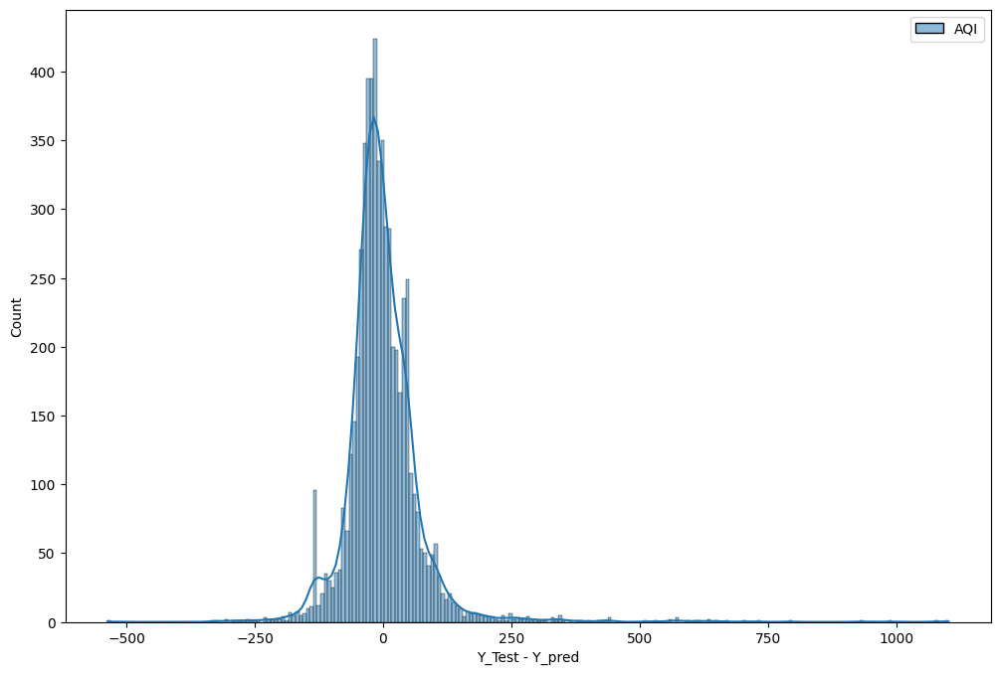

In [100]:
plt.figure(figsize = (12, 8))
sns.histplot(Y_test - Y_pred, kde = True)
plt.xlabel("Y_Test - Y_pred")
plt.ylabel("Count")

In [101]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score


mae =  mean_absolute_error(Y_test, Y_pred)
mse = mean_squared_error(Y_test, Y_pred)
r2score = r2_score(Y_test, Y_pred)

print("Mean Absolute Error : ", mae)
print("Mean Squared Error : ", mse) 
print("Root Mean Squared Error : ", np.sqrt(mse))
print("R2 Score : ", r2score) 

Mean Absolute Error :  46.47595988354392
Mean Squared Error :  5931.629384461858
Root Mean Squared Error :  77.01707203251665
R2 Score :  0.6065395446110754


In [ ]:
df.sample(5)

In [102]:
#RANDOM FOREST REGRESSSOR


In [105]:
rfmodel = RandomForestRegressor()
rfmodel.fit(X_train,Y_train)


C:\Users\admin\AppData\Local\Temp\ipykernel_4736\3098765100.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



RandomForestRegressor()

In [104]:
Y_pred = rfmodel.predict(X_test)
print("Predicted values for Test set\n",Y_pred[:100])

Predicted values for Test set
 [166.17588447 166.17588447 137.10026559 188.86       362.82
  76.24       164.84840341 145.10635815 114.46463581  90.62854326
 382.97       159.18630346 104.02       258.59026559  88.94927163
  68.77463581 123.99390744 171.59781489 109.74927163 164.84840341
  95.47854326 147.65808048 166.46358149 345.15463581  74.54927163
 166.46358149  78.83        78.97463581 167.32487545 166.31894567
 415.36       166.46358149  83.80927163 107.56       163.75442927
  93.08       540.87        85.19463581 172.89463581 133.97463581
 105.78927163 116.9        104.93122089  63.07463581 294.56390744
 482.12927163 220.13317907 373.86927163 104.97       350.51
 161.96317907 595.80927163  97.54       106.97       314.89927163
 304.30463581 124.48854326  51.27        94.74        51.7
  79.78463581  55.01       163.23172233  65.94927163 159.42927163
 126.40854326 103.38927163 111.65676044 160.6257666   47.04
 106.8        225.53463581 145.70417304 343.66       333.03463581
 182

In [106]:
rfmodel.score(X_train, Y_train)

0.9814789887495547

In [107]:
rfmodel.score(X_test, Y_test)

0.8762288506675353

In [110]:
mae =  mean_absolute_error(Y_test, Y_pred)
mse = mean_squared_error(Y_test, Y_pred)
r2score = r2_score(Y_test, Y_pred)

print("Mean Absolute Error : ", mae)
print("Mean Squared Error : ", mse) 
print("Root Mean Squared Error : ", np.sqrt(mse))
print("R2 Score : ", r2score) 

Mean Absolute Error :  21.73133608934055
Mean Squared Error :  1864.0174417943383
Root Mean Squared Error :  43.174268283253376
R2 Score :  0.8763548590168977


In [ ]:
#Decision Tree Regressor

In [111]:
des = DecisionTreeRegressor()
des.fit(X_train,Y_train)

DecisionTreeRegressor()

In [113]:
Y_pred  = des.predict(X_test)
print("Predicted values of test set\n",Y_pred[:100])

Predicted values of test set
 [166.16271051 166.16271051 147.         201.         347.
  73.         164.84062105 135.          90.          83.
 350.         166.46358149 268.         117.          78.
  65.         119.         143.          94.         164.84062105
  89.         146.         166.46358149 391.          79.
 166.46358149  65.          68.         166.46358149 166.46358149
 429.         166.46358149  82.          88.         177.
  79.         597.          74.         174.         145.
  57.          87.         105.         109.         317.
 512.         200.         370.         101.         356.
 154.         519.          64.          98.         331.
 302.         117.          65.          86.          34.
 121.          55.         134.          60.         156.
 137.          96.         105.         166.46358149  38.
 102.         223.         166.46358149 417.         328.
 236.         166.6535717  212.         138.         143.
 227.         143.        

In [114]:
des.score(X_train, Y_train)

0.9993907463842377

In [115]:
des.score(X_test,Y_test)

0.776776888079955

In [116]:
mae =  mean_absolute_error(Y_test, Y_pred)
mse = mean_squared_error(Y_test, Y_pred)
r2score = r2_score(Y_test, Y_pred)

print("Mean Absolute Error : ", mae)
print("Mean Squared Error : ", mse) 
print("Root Mean Squared Error : ", np.sqrt(mse))
print("R2 Score : ", r2score) 

Mean Absolute Error :  29.36855200291206
Mean Squared Error :  3365.209265177981
Root Mean Squared Error :  58.01042376313055
R2 Score :  0.776776888079955


## Conclusion

1.Three models had been trained, namely Multiple Linear Regression, Random Forest Regression and Decision Tree Regression respectively.

2.Among the three, the least RMSE score and highest R2_Score was seen for Random Forest Regression.

3.Therefore, the best model for prediction is Random Forest Regression.